In [13]:
import sys
import os
import json
import numpy as np
import pandas as pd
import geopandas as gpd
import imageio
from datetime import datetime, date, timedelta
import matplotlib.pyplot as plt
%matplotlib inline

from PIL import Image
from PIL import ImageFont
from PIL import ImageDraw

import matplotlib.font_manager as font_manager
font_files = font_manager.findSystemFonts()

# First 2000 images (5 fields each)

In [ ]:
# image_dir = '../mount/data/airbus/false_color/GeneralBlockchain_n2000_June2021/'
# image_names = os.listdir(image_dir)

# for i, image_name in enumerate(image_names):
#     if i % 100 == 0:
#         print(i)
#     image_path = os.path.join(image_dir, image_name)
#     image_id = image_name.split('C')[-1].split('.')[0]
#     new_image_id = image_id.zfill(4)
#     os.rename(image_path, os.path.join(image_dir, 'airbus_geowiki_C'+new_image_id+'.png'))

## Filter Airbus images

In [7]:
geowiki = pd.read_csv('../mount/data/GeoWiki/geowiki_dominant-field-size_in-india.csv')
geowiki.head()

,sampleid,x,y,name,name_value,0
0,965550,83.837502,26.284401,Very small (<0.64ha),1.0,2
1,965539,72.795799,27.176001,Medium (2.56 ha -16 ha),3.0,2
2,965538,82.545799,20.934401,Very small (<0.64ha),1.0,4
3,965534,76.795799,29.659401,Very small (<0.64ha),1.0,3
4,965533,85.845802,22.184401,Very small (<0.64ha),1.0,3


In [5]:
base_dir = '../mount/data/airbus/false_color/GeneralBlockchain_n2000_June2021'
image_names = sorted(os.listdir(base_dir), reverse=True)

# image_ids = [int(x.split('_')[-1].split('.')[0]) for x in image_names]
# samples = geowiki[geowiki['image_id'].isin(image_ids)].sort_values('image_id').reset_index(drop=True)

In [9]:
pd.DataFrame({'image_name': image_names}).to_csv(
    '../mount/data/airbus/false_color/geowiki_india_2020-09-01_to_2021-03-01.csv', index=False)

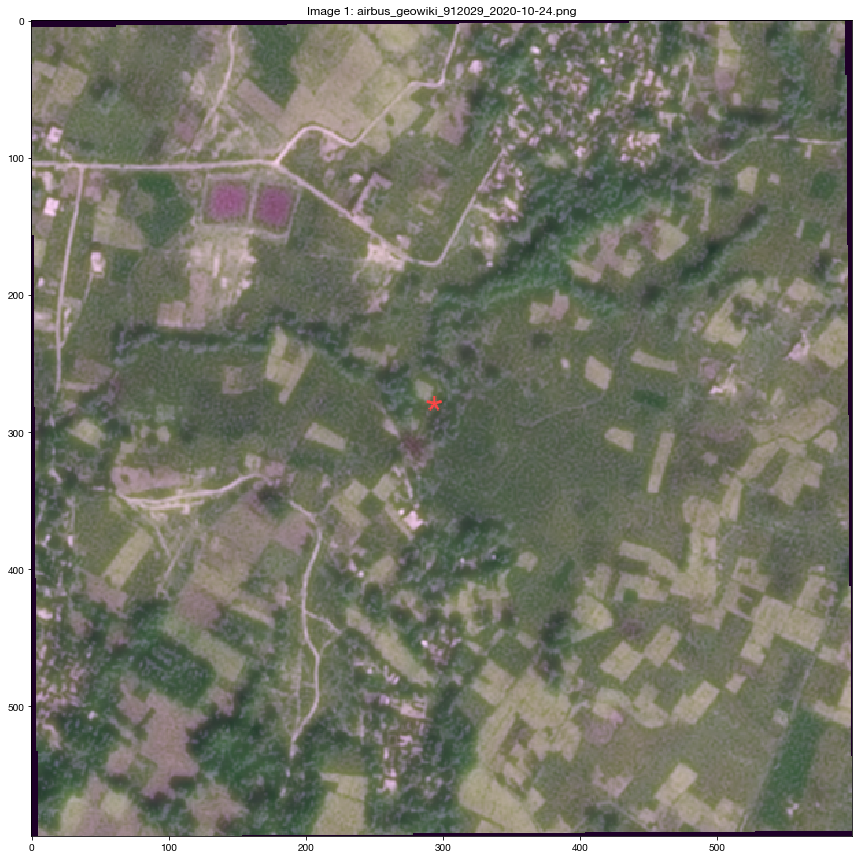

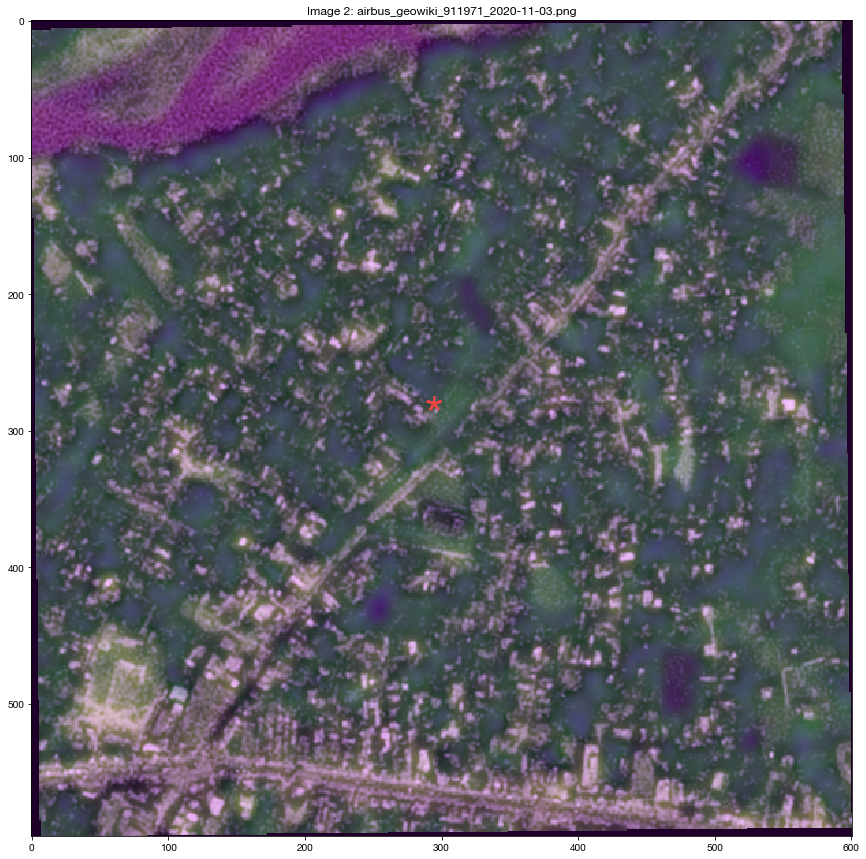

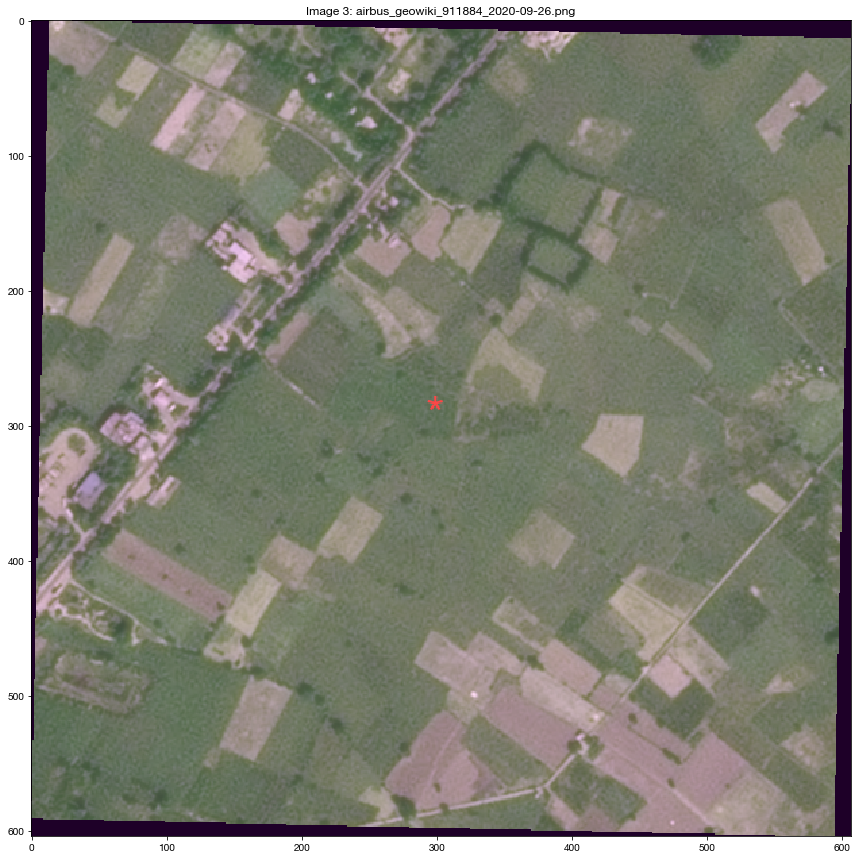

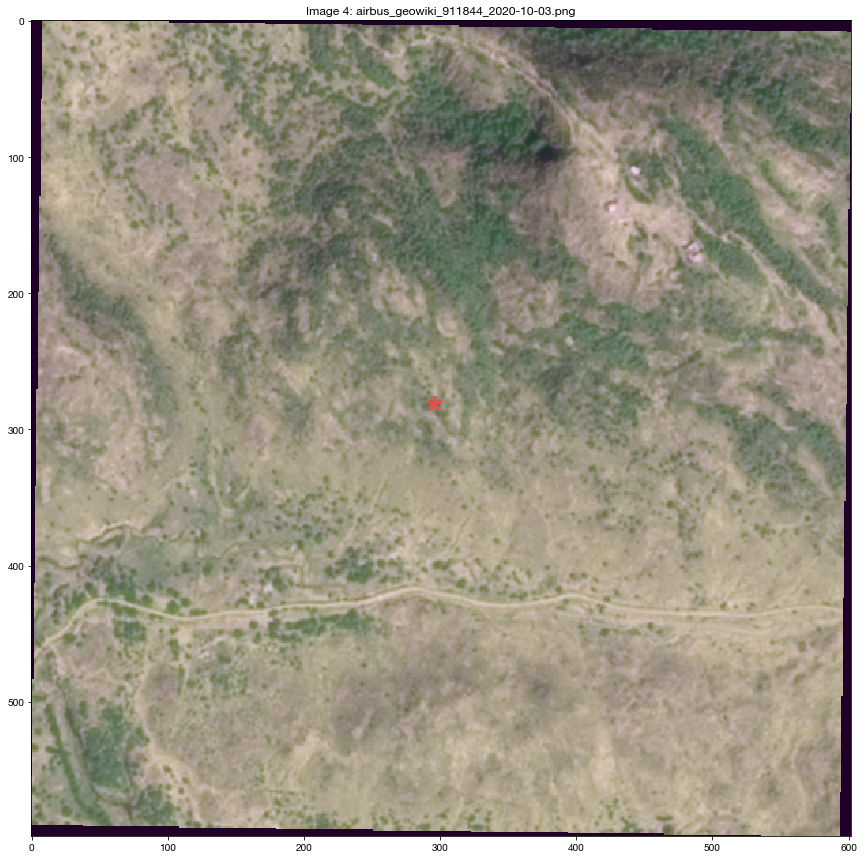

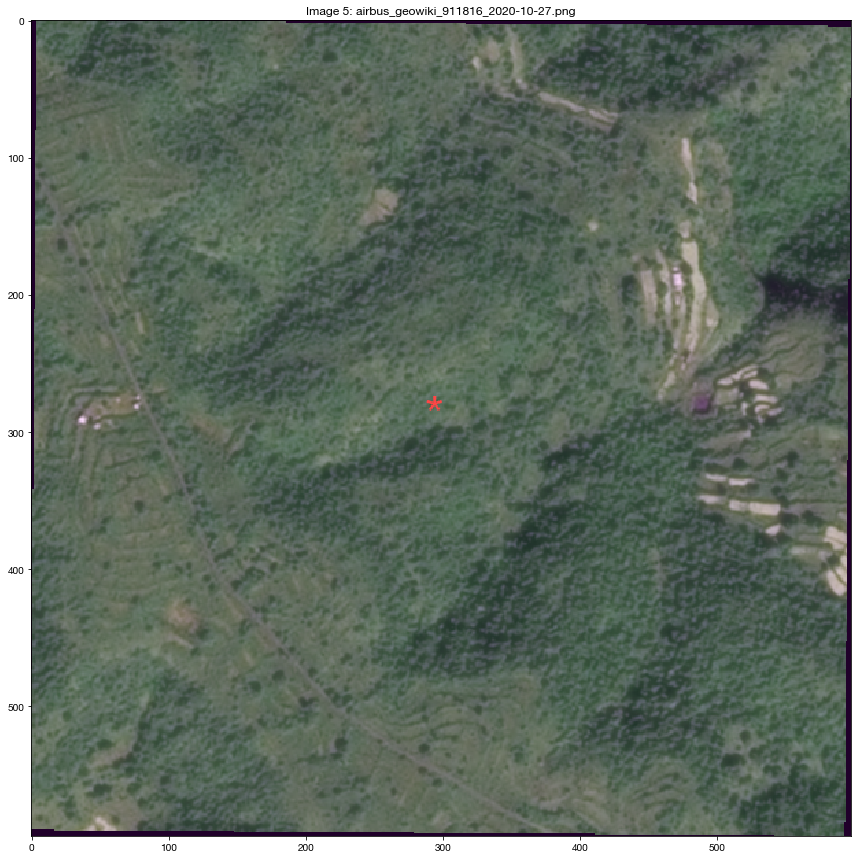

...

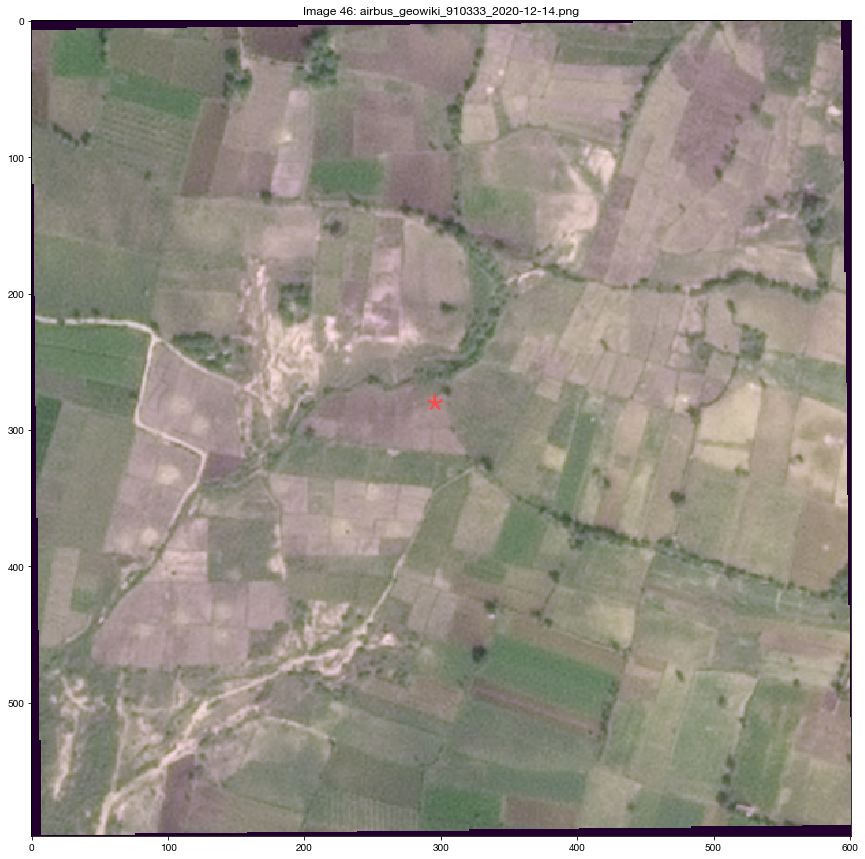

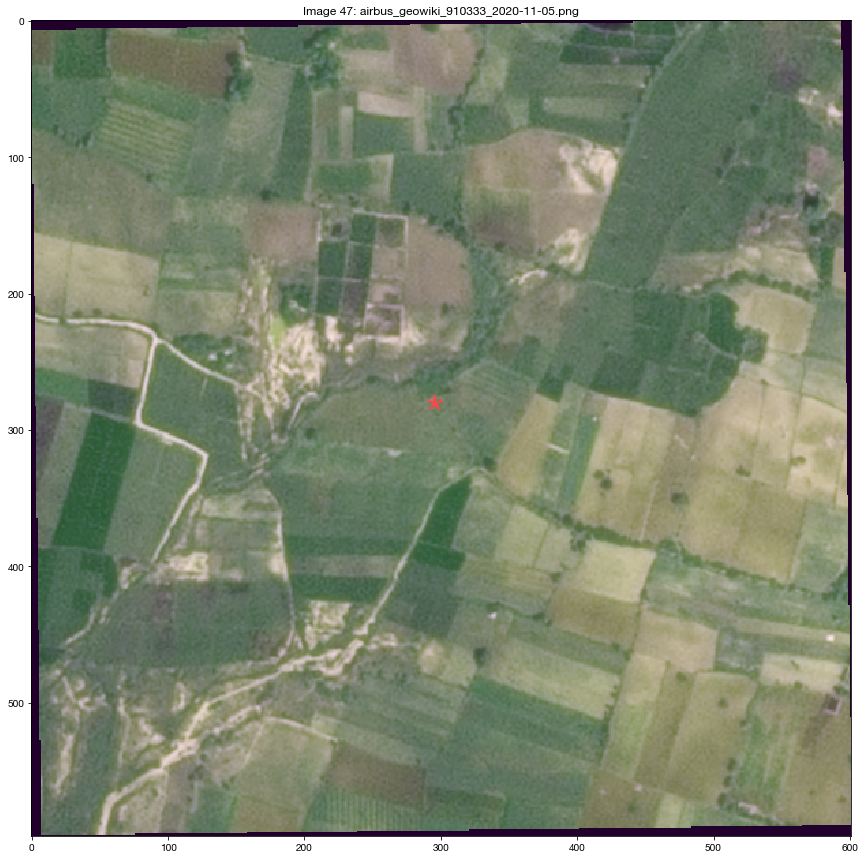

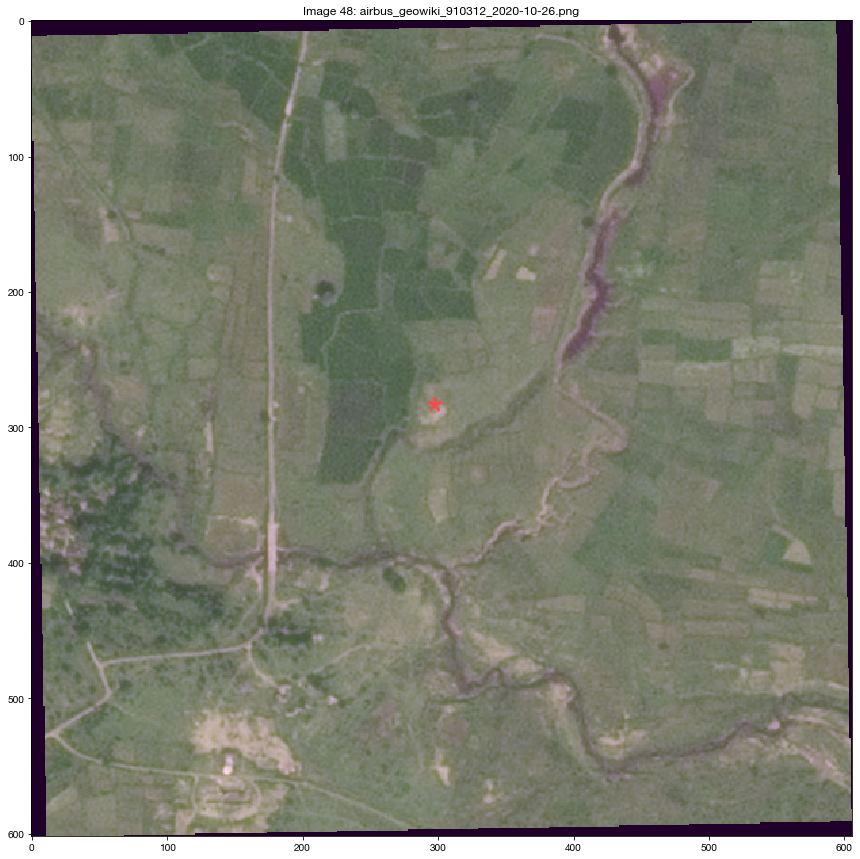

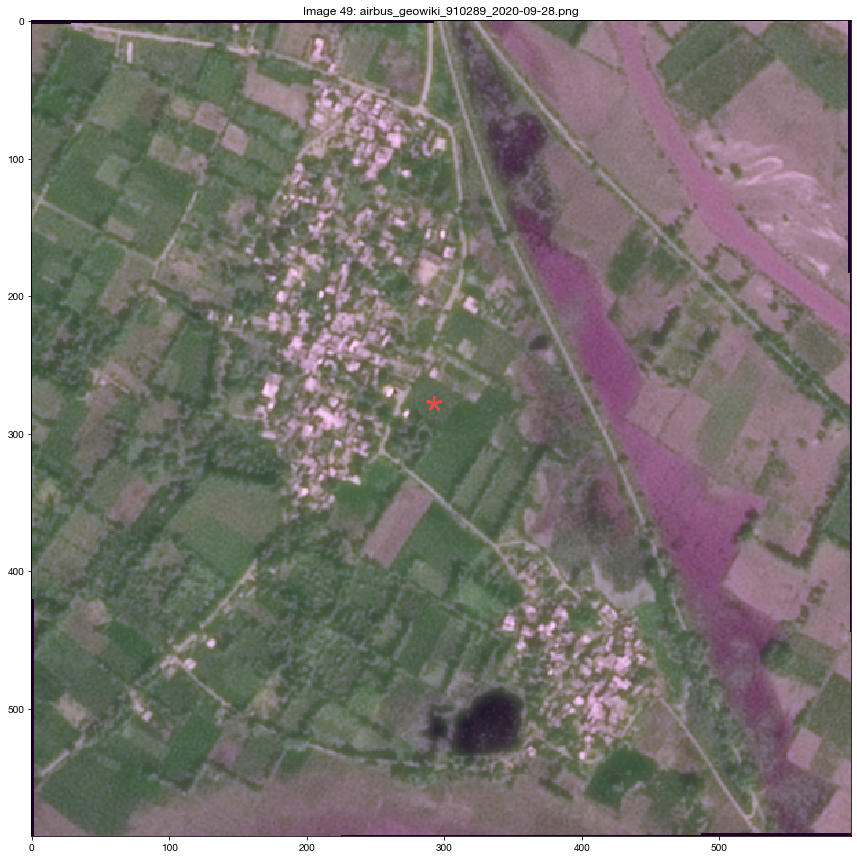

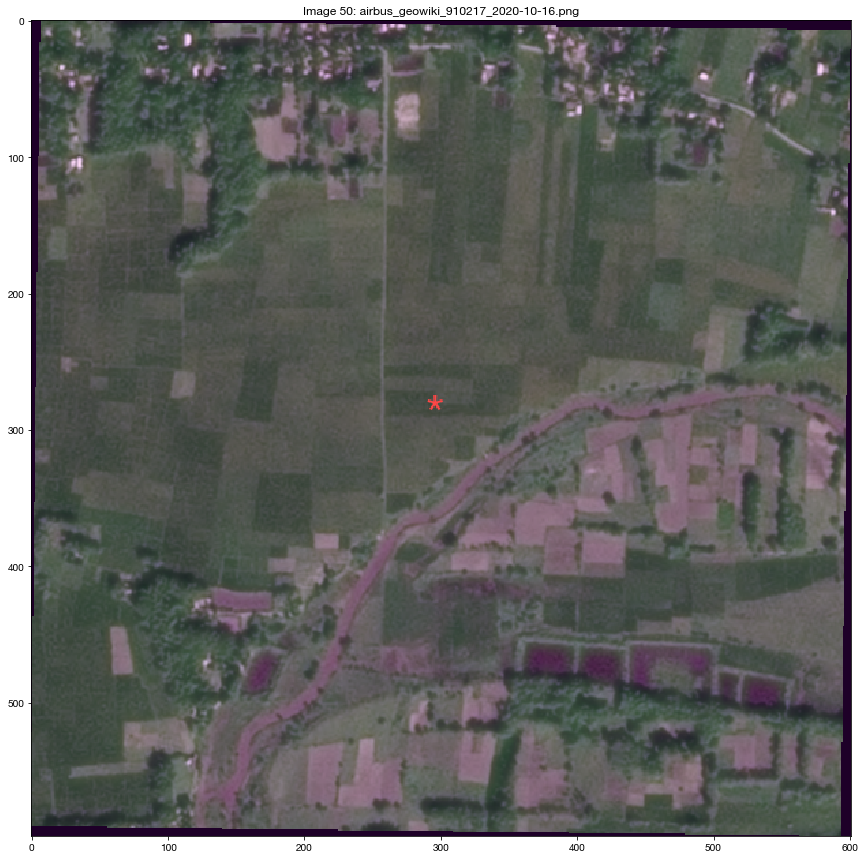

In [109]:
font = ImageFont.truetype('/usr/share/fonts/truetype/liberation/LiberationSans-Regular.ttf', 32)
for i, image_name in enumerate(sorted(image_names, reverse=True)[2950:3000]):
    img = Image.open(os.path.join(base_dir, image_name))
    x_center, y_center = img.size[1]/2., img.size[0]/2.
    draw = ImageDraw.Draw(img)
    draw.text((x_center-9, y_center-32), "*", (255, 70, 70), font=font)
    
    fig, ax = plt.subplots(figsize=(15,15))
    plt.imshow(img)
    
    plt.title("Image {}: ".format(i+1) + image_name)
    plt.show()

### Filtering results

In [2]:
# first 601 images
# filtered = pd.read_csv('../mount/data/airbus/false_color/geowiki_india_2020-09-01_to_2021-03-01_batch1_filtered.csv')

# 3000 images
filtered = pd.read_csv('../mount/data/airbus/false_color/geowiki_india_2020-09-01_to_2021-03-01_labeled.csv')
filtered.head()

,image_name,image_quality
0,airbus_geowiki_965550_2020-10-12.png,0.0
1,airbus_geowiki_965539_2020-10-06.png,0.0
2,airbus_geowiki_965538_2020-11-07.png,0.0
3,airbus_geowiki_965534_2020-10-01.png,0.0
4,airbus_geowiki_965533_2020-11-09.png,0.0


In [3]:
filtered.groupby('image_quality').size()

image_quality
0.0    2011
1.0     519
3.0     288
4.0     182
dtype: int64

In [4]:
filtered['geowiki_id'] = filtered['image_name'].str.split('_').apply(lambda x: x[2])
filtered.sort_values('image_quality', ascending=False).drop_duplicates('geowiki_id', keep='last').groupby('image_quality').size()

image_quality
0.0    2003
1.0     159
3.0     240
4.0      44
dtype: int64

In [106]:
filtered.dropna(subset=['image_quality']).drop_duplicates('geowiki_id').shape

(2354, 3)

In [5]:
india = gpd.read_file('../mount/data/gadm36_IND_shp/gadm36_IND_0.shp')

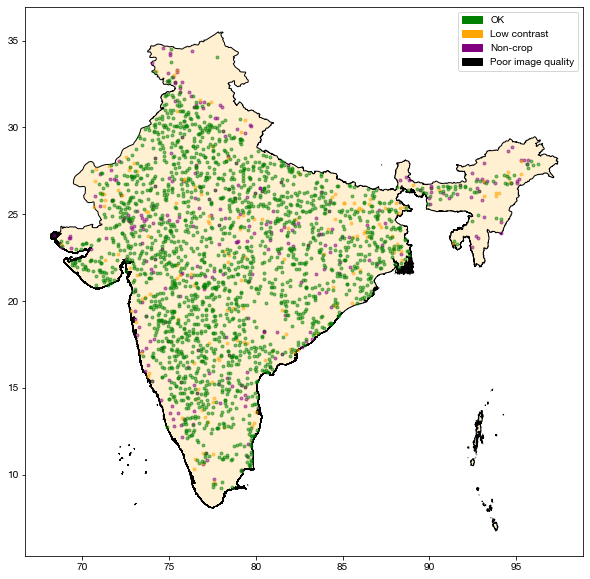

In [8]:
filtered_best = filtered.sort_values('image_quality', ascending=False).drop_duplicates('geowiki_id', keep='last')
filtered_best = filtered_best.dropna(subset=['image_quality'])

fig, ax = plt.subplots(1, figsize=(10,15))
india.plot(ax=ax, edgecolor='black', color='#fff0d1')

colors = ['g', 'orange', 'r', 'purple', 'black']
for i, row in filtered_best.iterrows():
    geowiki_id = int(row['geowiki_id'])
    lon = geowiki[geowiki['sampleid'] == geowiki_id]['x'].values[0]
    lat = geowiki[geowiki['sampleid'] == geowiki_id]['y'].values[0]
    quality = row['image_quality']
    
    plt.plot([lon], [lat], 'o', ms=3, color=colors[int(quality)], alpha=0.5)
    
import matplotlib.patches as mpatches
green_data = mpatches.Patch(color='g', label='OK')
red_data = mpatches.Patch(color='orange', label='Low contrast')
purple_data = mpatches.Patch(color='purple', label='Non-crop')
black_data = mpatches.Patch(color='black', label='Poor image quality')
plt.legend(handles=[green_data, red_data, purple_data, black_data])
plt.show()

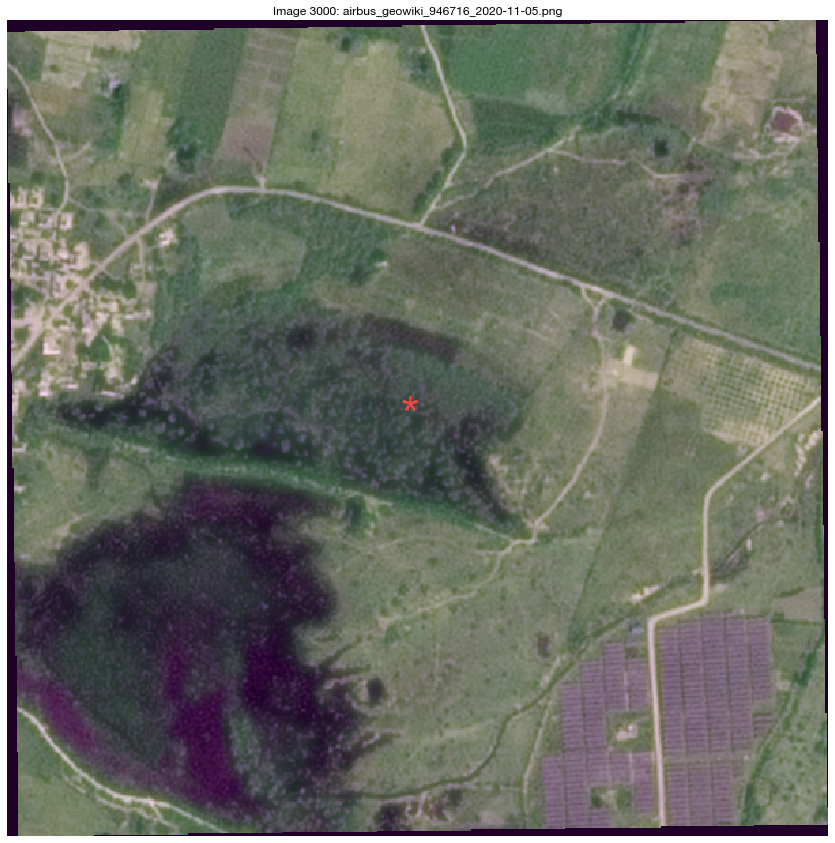

In [114]:
# try to salvage images with low contrast
low_contrast_image_names = filtered_best[filtered_best['image_quality'] == 2]['image_name'].values[:3]
font = ImageFont.truetype('/usr/share/fonts/truetype/liberation/LiberationSans-Regular.ttf', 32)

for image_name in low_contrast_image_names:

    img = Image.open(os.path.join(base_dir, image_name))
    x_center, y_center = img.size[1]/2., img.size[0]/2.
    draw = ImageDraw.Draw(img)
    draw.text((x_center-9, y_center-32), "*", (255, 70, 70), font=font)

    fig, ax = plt.subplots(figsize=(15,15))
    plt.imshow(img)

    plt.title("Image {}: ".format(i+1) + image_name)
    plt.axis('off')
    plt.show()

# Save 2000 best images

In [48]:
base_dir = '../mount/data/airbus/false_color/GeneralBlockchain_n2000_June2021'
save_dir = '../data/general_blockchain/airbus_false_color/campaign1/'

image_names = filtered_best[filtered_best['image_quality'] == 0]['image_name'].values
font = ImageFont.truetype('/usr/share/fonts/truetype/liberation/LiberationSans-Regular.ttf', 32)
new_names = []
for i, image_name in enumerate(image_names):
    if i % 100 == 0:
        print("finished image {}".format(i))
    img = Image.open(os.path.join(base_dir, image_name))
    x_center, y_center = int(img.size[1]/2.), int(img.size[0]/2.)
    draw = ImageDraw.Draw(img)
    draw.text((y_center-6, x_center-13), "*", (255, 70, 70), font=font)
    new_name = 'airbus_geowiki_C{}.png'.format(str(i).zfill(4))
    new_names.append(new_name)
    img.save(os.path.join(save_dir, new_name))

finished image 0
finished image 100
finished image 200
finished image 300
finished image 400
finished image 500
finished image 600
finished image 700
finished image 800
finished image 900
finished image 1000
finished image 1100
finished image 1200
finished image 1300
finished image 1400
finished image 1500
finished image 1600
finished image 1700
finished image 1800
finished image 1900
finished image 2000


In [50]:
images_to_send = filtered_best[filtered_best['image_quality'] == 0]
images_to_send['campaign_name'] = new_names

/home/swang222/anaconda3/envs/geopython/lib/python3.7/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  from ipykernel import kernelapp as app


In [52]:
images_to_send.to_csv('../data/general_blockchain/geowiki_campaign1.csv', index=False)
images_to_send.head()

,image_name,image_quality,geowiki_id,campaign_name
1818,airbus_geowiki_948712_2020-09-30.png,0.0,948712,airbus_geowiki_C0000.png
1814,airbus_geowiki_948718_2020-10-28.png,0.0,948718,airbus_geowiki_C0001.png
2962,airbus_geowiki_911495_2020-09-12.png,0.0,911495,airbus_geowiki_C0002.png
2100,airbus_geowiki_945850_2020-10-10.png,0.0,945850,airbus_geowiki_C0003.png
2077,airbus_geowiki_946126_2020-11-05.png,0.0,946126,airbus_geowiki_C0004.png


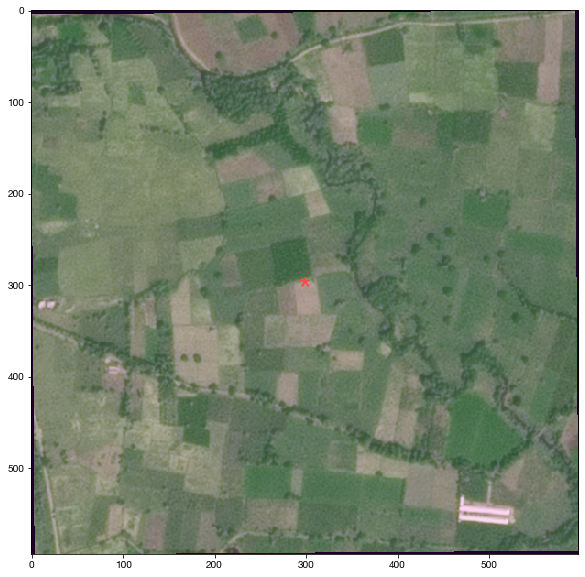

In [55]:
# check saved images
img = imageio.imread('../data/general_blockchain/airbus_false_color/campaign1/airbus_geowiki_C1900.png')
fig, ax = plt.subplots(1, 1, figsize=(10,10))
plt.imshow(img)
plt.show()

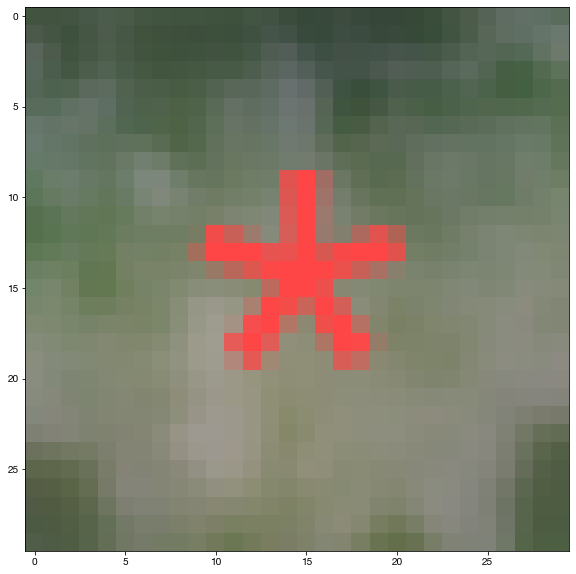

In [54]:
# check saved images
img = imageio.imread('../data/general_blockchain/airbus_false_color/campaign1/airbus_geowiki_C0020.png')
fig, ax = plt.subplots(1, 1, figsize=(10,10))
plt.imshow(img[x_center-15:x_center+15, y_center-15:y_center+15])
plt.show()